In [15]:
import os
import random
import argparse
import matplotlib
from plantcv import plantcv as pcv

In [81]:
class options:
    def __init__(self):
        self.debug      = "plot"
        self.writeimg   = False
        self.dir_image  = '/shares/mgehan_share/raw_data/raw_image/nappn-workshop-2021/10.9.1.29_wtCol_highCo2_BR1'
        self.result     = './data_outputs'
        self.outdir     = './img_outputs'
args = options() 
pcv.params.debug = "plot"
%matplotlib inline

In [17]:
list_all = [f for f in os.listdir(args.dir_image) if f.endswith('.jpg')]

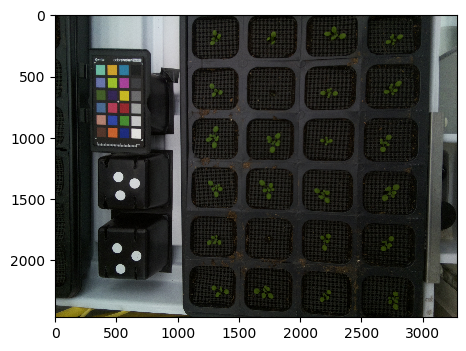

In [48]:
filename = random.choice(list_all)
img, path, filename = pcv.readimage(filename=os.path.join(args.dir_image, filename))


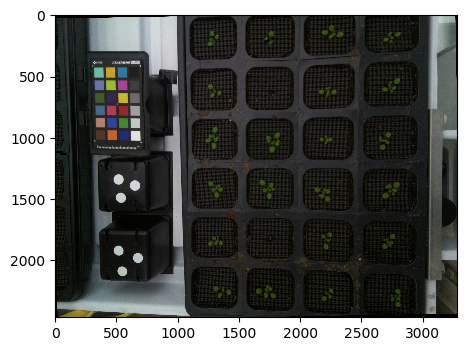

In [64]:
rot_img = pcv.rotate(img=img, rotation_deg=1, crop=True)

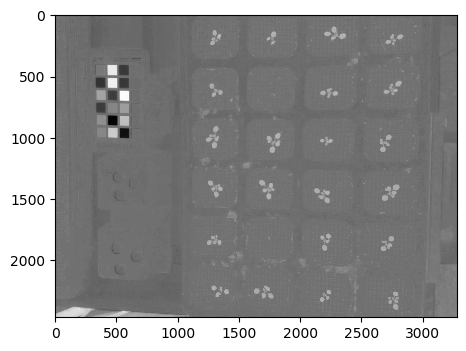

In [50]:
#### Create a mask and begin to clean it ####

# Change color space for plant extraction
b = pcv.rgb2gray_lab(rgb_img=img, channel="b")


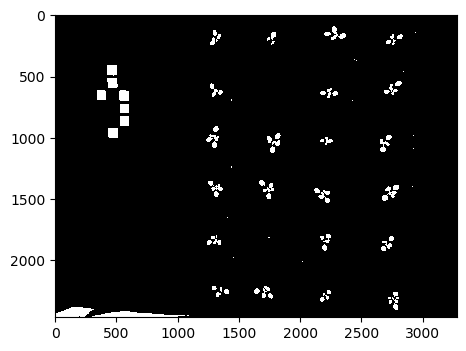

In [51]:
# Threshold
b_thresh = pcv.threshold.binary(gray_img=b, threshold=145, max_value=255, object_type='light')


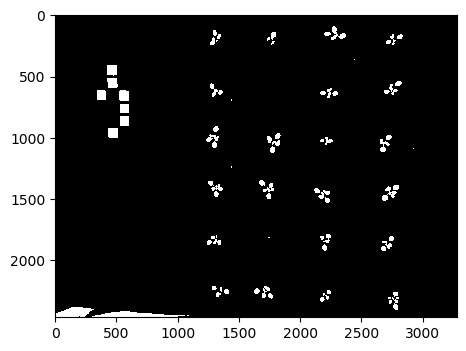

In [52]:
# Fill in small objects 
b_fill_image = pcv.fill(bin_img=b_thresh, size=50)


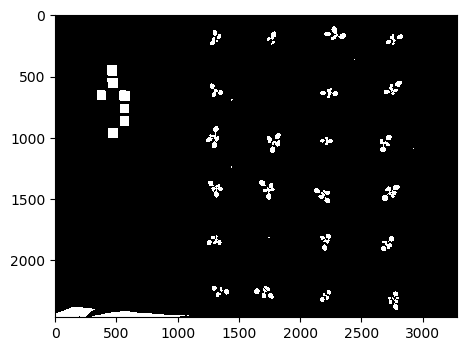

In [53]:
# Dilate 
b_dilated = pcv.dilate(gray_img=b_fill_image, ksize=2, i=1)

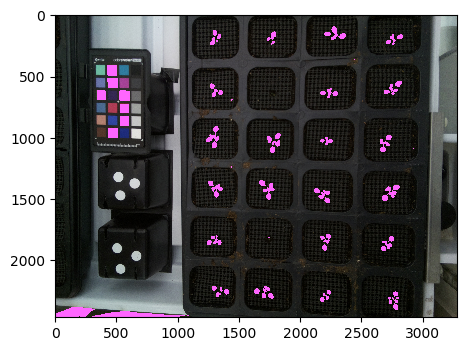

In [71]:
obj, obj_hierarchy = pcv.find_objects(img=img, mask=b_dilated)

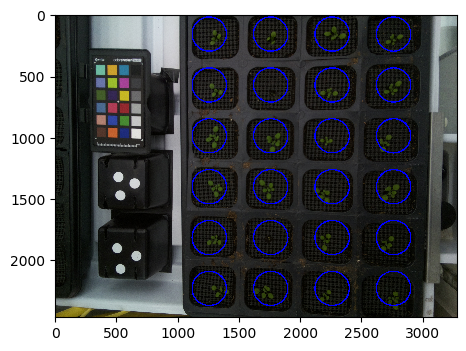

In [65]:
# Create a grid of ROIs 
pcv.params.line_thickness = 10
rois1, roi_hierarchy1 = pcv.roi.multi(img=img, coord=(1255, 155), radius=140, 
                                      spacing=(500, 415), nrows=6, ncols=4)

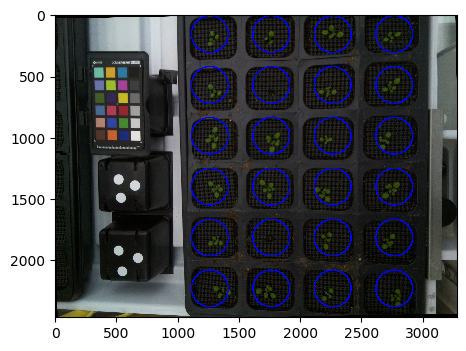

In [68]:
rois1, roi_hierarchy1 = pcv.roi.multi(img=rot_img, coord=(1260, 155), radius=150, 
                                      spacing=(500, 415), nrows=6, ncols=4)

In [79]:
plant_id = range(0,len(rois1))

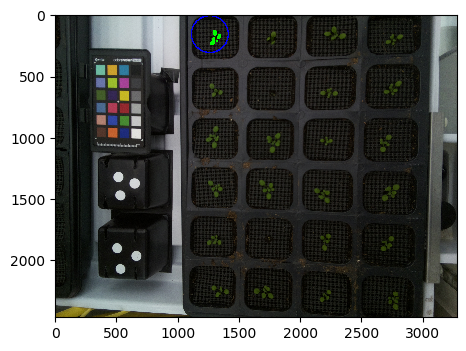

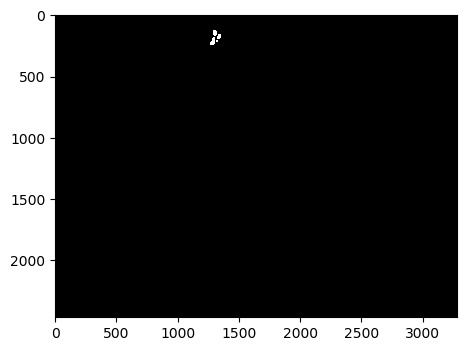

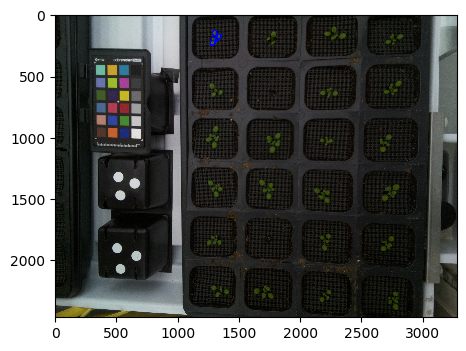

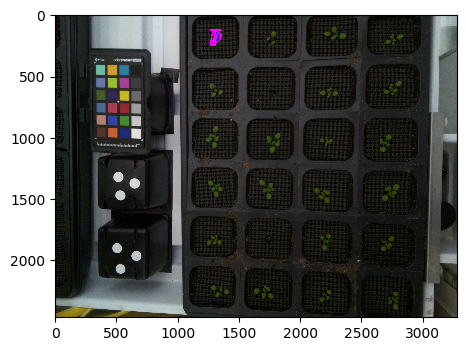

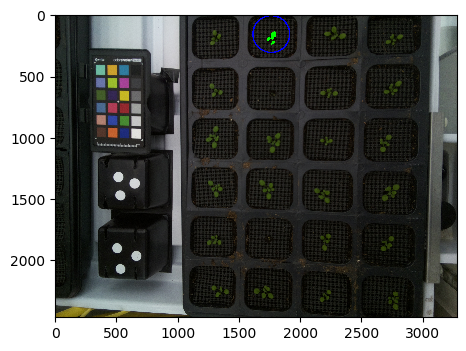

...

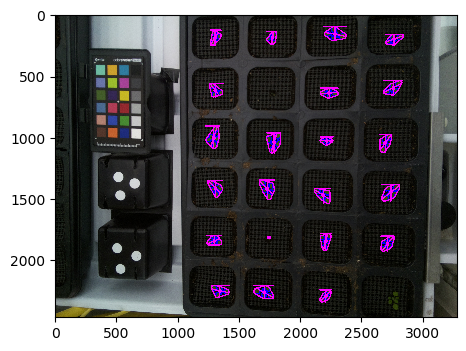

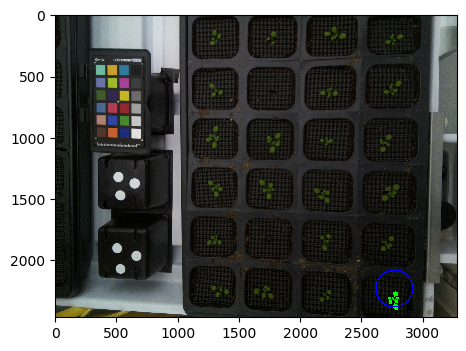

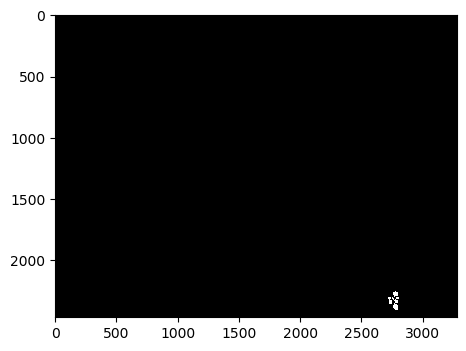

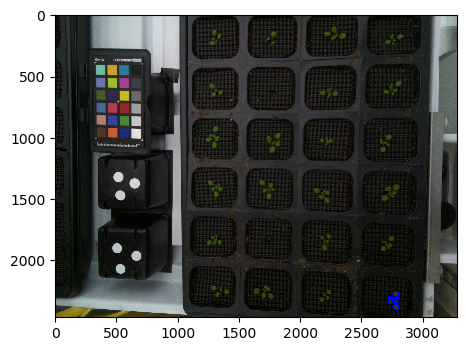

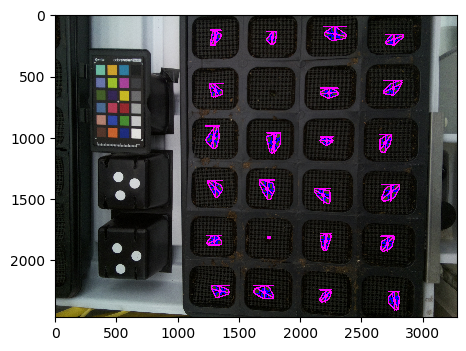

In [80]:
import numpy as np
img_copy = np.copy(img)

for i in range(0, len(rois1)):
    roi = rois1[i]
    hierarchy = roi_hierarchy1[i]
    id_label = plant_id[i]
    # Find objects
    filtered_contours, filtered_hierarchy, filtered_mask, filtered_area = pcv.roi_objects(
        img=img, roi_type="partial", roi_contour=roi, roi_hierarchy=hierarchy, object_contour=obj, 
        obj_hierarchy=obj_hierarchy)

    # Combine objects together in each plant     
    plant_contour, plant_mask = pcv.object_composition(img=img, contours=filtered_contours, hierarchy=filtered_hierarchy)        

    if plant_contour is not None:
        # Analyze the shape of each plant 
        analysis_images = pcv.analyze_object(img=img_copy, obj=plant_contour, mask=plant_mask)
        # analysis_images = pcv.analyze_object(img=img_copy, obj=plant_contour, mask=plant_mask, label=id_label)

        # Save the image with shape characteristics 
        img_copy = analysis_images


In [82]:
pcv.print_results(filename=args.result)